<a href="https://colab.research.google.com/github/DJ-Manjaray/Generative-Adversarial-Network-GAN-from-Scratch-Build-Train/blob/main/Output_Generative_Adversarial_Network_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Training DCGAN on the Fashion-MNIST dataset

Idea behind this : Grayscale images require less computational power to train convolutional networks on one-channel grayscale images compared to three-channel colored images, which makes it easier for you to train on a personal computer without a GPU.

---



In [3]:
from __future__ import print_function, division
from keras.datasets import fashion_mnist

from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers import BatchNormalization, Activation, ZeroPadding2D
from keras.layers import ELU, PReLU, LeakyReLU
from keras.layers import Convolution2D as Conv2D , UpSampling2D
from keras.models import Sequential, Model
from keras.optimizers.legacy import Adam

import numpy as np
import matplotlib.pyplot as plt

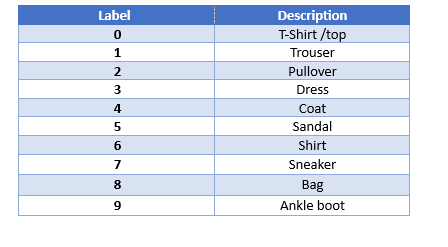

## Load the dataset

In [4]:
(training_data, _), (_, _) = fashion_mnist.load_data()
X_train = training_data / 127.5 - 1.
X_train = np.expand_dims(X_train, axis=3)

## Visualize an image of the dataset

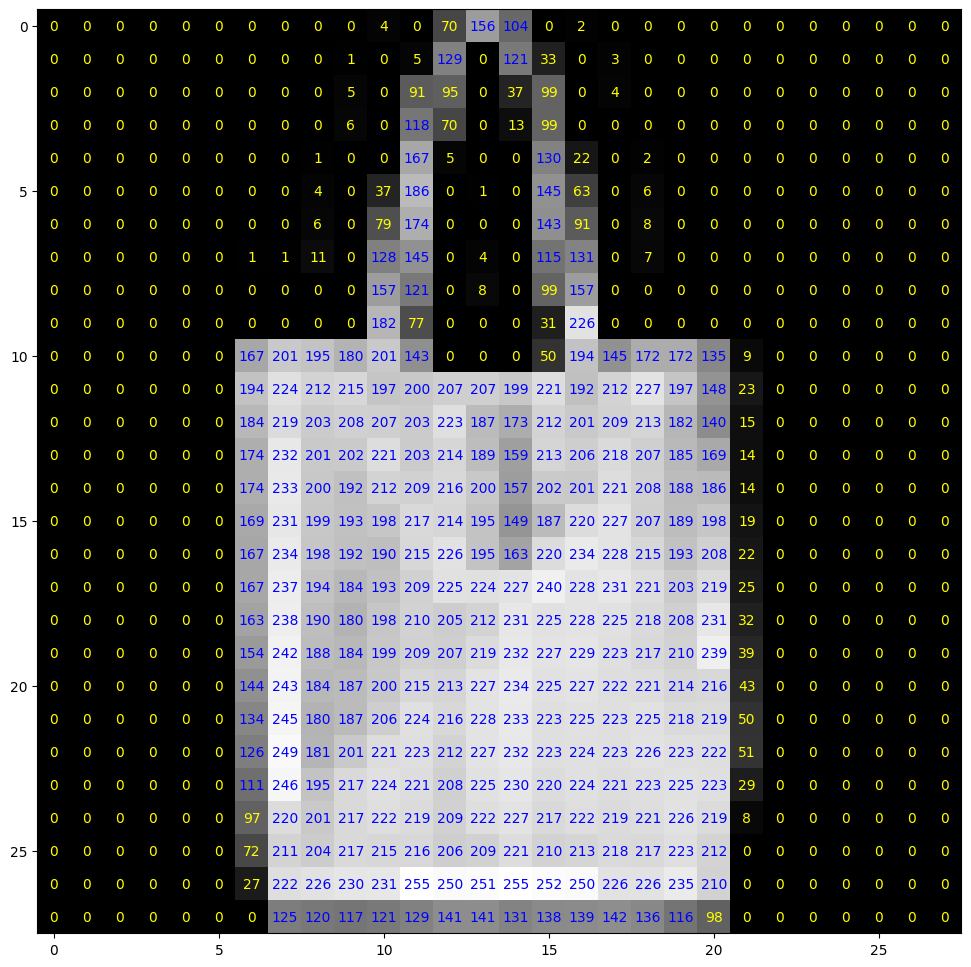

In [5]:
def visualize_input(img, ax):
    ax.imshow(img, cmap='gray')
    width, height = img.shape
    thresh = img.max()/2.5
    for x in range(width):
        for y in range(height):
            ax.annotate(str(round(img[x][y],2)), xy=(y,x),
                        horizontalalignment='center',
                        verticalalignment='center',
                        color='yellow' if img[x][y]<thresh else 'blue')

fig = plt.figure(figsize = (12,12))

ax = fig.add_subplot(111)
visualize_input(training_data[3343], ax)

**Building the Generator Model**

**Generator** | **Discriminator**

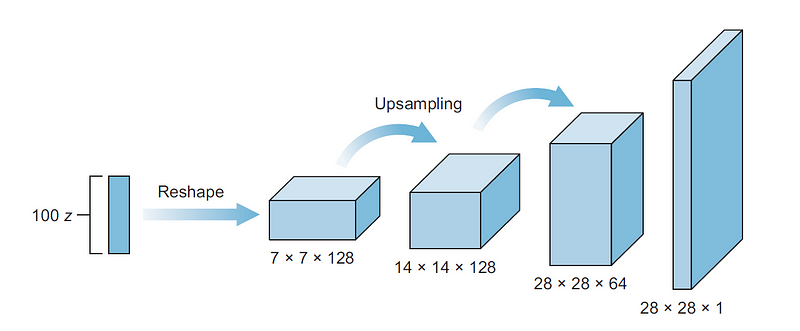

Ref : [Deep Convolutional Generative Adversarial Networks](https://arxiv.org/abs/1511.06434)

In [6]:
def build_generator():
  """
  Here is a Construct a Convolutional Neural Network (CNN) architecture for a generator model within a Generative Adversarial Network (GAN).

  """

  # Create a Sequential model for generator
  generator = Sequential()

  generator.add(Dense(6272, activation="relu", input_dim=100)) # Add dense layer
  generator.add(Reshape((7, 7, 128)))  # reshape the image
  generator.add(UpSampling2D()) # Upsampling layer to double the size of the image
  generator.add(Conv2D(128, kernel_size=3, padding="same", activation="relu"))
  generator.add(BatchNormalization(momentum=0.8))
  generator.add(UpSampling2D())

  # convolutional + batch normalization layers
  generator.add(Conv2D(64, kernel_size=3, padding="same", activation="relu"))
  generator.add(BatchNormalization(momentum=0.8))

  # convolutional layer with filters = 1
  generator.add(Conv2D(1, kernel_size=3, padding="same", activation="relu"))
  generator.summary() # prints the model summary

  """
  We don't add upsampling here because the image size of 28 × 28 is
  equal to the image size in the MNIST dataset.
  You can adjust this for your own problem.
  """

  noise = Input(shape=(100,))
  fake_image = generator(noise)

  # Returns a model that takes the noise vector as an input and outputs the fake image
  return Model(inputs=noise, outputs=fake_image)


**Building the Discriminator Model**

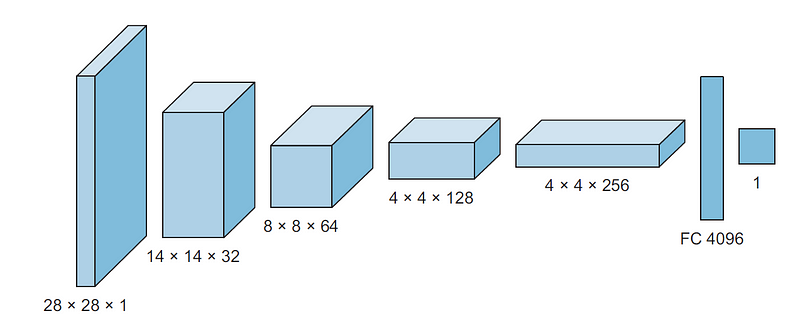

In [7]:
def build_discriminator():
  """
   Here is a Construct a Convolutional Neural Network (CNN) architecture for a discriminator model within a Generative Adversarial Network (GAN).
  """

  # Create a Sequential model for discriminator
  discriminator = Sequential()

  # Convolutional 2D layers with LeakyReLU activation function and Dropout layer
  discriminator.add(Conv2D(32, kernel_size=3, strides=2, input_shape=(28,28,1), padding="same"))
  discriminator.add(LeakyReLU(alpha=0.2))
  discriminator.add(Dropout(0.25))

  # Convolutional 2D layers with BatchNormalization function and ZeroPadding layer
  discriminator.add(Conv2D(64, kernel_size=3, strides=2,padding="same"))
  discriminator.add(ZeroPadding2D(padding=((0,1),(0,1))))
  discriminator.add(BatchNormalization(momentum=0.8))

  discriminator.add(LeakyReLU(alpha=0.2))
  discriminator.add(Dropout(0.25))

  discriminator.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
  discriminator.add(BatchNormalization(momentum=0.8))
  discriminator.add(LeakyReLU(alpha=0.2))
  discriminator.add(Dropout(0.25))

  discriminator.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
  discriminator.add(BatchNormalization(momentum=0.8))
  discriminator.add(LeakyReLU(alpha=0.2))
  discriminator.add(Dropout(0.25))

  # Flattens the 3D output of the convolutional layers into a 1D vector for dense layers.
  discriminator.add(Flatten())

  # Adds a dense layer with a single unit and sigmoid activation function to output a probability (real or fake image).
  discriminator.add(Dense(1, activation='sigmoid'))

  # Input layer for the discriminator
  img = Input(shape=(28,28,1))

  # Obtain the probability of the input image being real from the discriminator
  probability = discriminator(img)

  # Create and return the Model
  return Model(inputs=img, outputs=probability)

**Building the Combined Model**

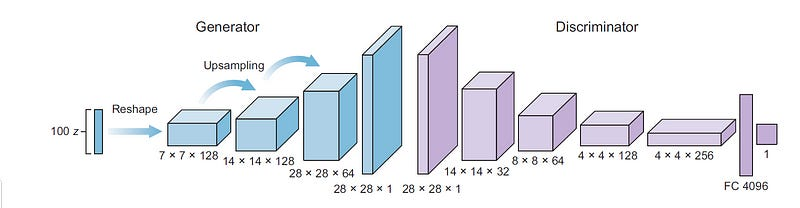

**Important** : *Disable discriminator training for the combined model. When training the generator, we don’t want the discriminator to update weights. However, we still want to include the discriminator model in the generator training. To achieve this, we create a combined network that includes both models but freezes the weights of the discriminator model in the combined network.*

In [8]:
# Input shape
img_shape = (28,28,1)
channels = 1
latent_dim = 100

In [9]:
# optimizer = Adam(0.0002, 0.5)
optimizer = Adam(learning_rate=0.0002, beta_1=0.5)

# Build and compile the discriminator
discriminator = build_discriminator()
discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

In [10]:
# Build the generator
generator = build_generator()

# The generator takes noise as input and generates imgs
z = Input(shape=(latent_dim,))
img = generator(z)

# For the combined model we will only train the generator
discriminator.trainable = False

# The discriminator takes generated images as input and determines validity
valid = discriminator(img)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1 (Dense)             (None, 6272)              633472    
                                                                 
 reshape (Reshape)           (None, 7, 7, 128)         0         
                                                                 
 up_sampling2d (UpSampling2  (None, 14, 14, 128)       0         
 D)                                                              
                                                                 
 conv2d_4 (Conv2D)           (None, 14, 14, 128)       147584    
                                                                 
 batch_normalization_3 (Bat  (None, 14, 14, 128)       512       
 chNormalization)                                                
                                                                 
 up_sampling2d_1 (UpSamplin  (None, 28, 28, 128)      

In [11]:
# The combined model  (stacked generator and discriminator)
# Trains the generator to fool the discriminator
combined = Model(z, valid)
combined.compile(loss='binary_crossentropy', optimizer=optimizer)

## Building the Training Function

**Discriminator + Combined network**



*   Number of epochs
*   Batch Size
*   ```save_interval```

In [12]:
def plot_generated_images(epoch, generator, examples=100, dim=(10, 10),figsize=(10, 10)):
    noise = np.random.normal(0, 1, size=[examples, latent_dim])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(examples, 28, 28)

    plt.figure(figsize=figsize)

    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(generated_images[i], interpolation='nearest', cmap='gray_r')
        plt.axis('off')

    plt.tight_layout()
    plt.savefig('gan_generated_image_epoch_%d.png' % epoch)

In [13]:
def train(epochs, batch_size=128, save_interval=50):

    valid = np.ones((batch_size, 1))
    fake = np.zeros((batch_size, 1))

    for epoch in range(epochs):  # Train Discriminator network
        idx = np.random.randint(0, X_train.shape[0], batch_size)
        imgs = X_train[idx]

        noise = np.random.normal(0, 1, (batch_size, 100))
        gen_imgs = generator.predict(noise)


        d_loss_real = discriminator.train_on_batch(imgs, valid)
        d_loss_fake = discriminator.train_on_batch(gen_imgs, fake)
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

        g_loss = combined.train_on_batch(noise, valid)

        # printing progress
        print("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" %(epoch, d_loss[0], 100*d_loss[1], g_loss))

        if epoch % save_interval == 0:
            plot_generated_images(epoch, generator)

1/1 [==============================] - 0s 18ms/step
0 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.093480]
1/1 [==============================] - 0s 15ms/step
1 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.073043]
1/1 [==============================] - 0s 16ms/step
2 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.114593]
1/1 [==============================] - 0s 16ms/step
3 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.071875]
1/1 [==============================] - 0s 18ms/step
4 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.079020]
1/1 [==============================] - 0s 16ms/step
5 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.128326]
1/1 [==============================] - 0s 18ms/step
6 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.121253]
1/1 [==============================] - 0s 16ms/step
7 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.132793]
1/1 [==============================] - 0s 16ms/step
8 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.108948]
1/1 [==============================] 

<ipython-input-12-73dc409b19a6>:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=figsize)


Streaming output truncated to the last 5000 lines.
7524 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.486437]
1/1 [==============================] - 0s 15ms/step
7525 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.660898]
1/1 [==============================] - 0s 15ms/step
7526 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.190536]
1/1 [==============================] - 0s 15ms/step
7527 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.501310]
1/1 [==============================] - 0s 16ms/step
7528 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.403376]
1/1 [==============================] - 0s 17ms/step
7529 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.254038]
1/1 [==============================] - 0s 20ms/step
7530 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.884575]
1/1 [==============================] - 0s 18ms/step
7531 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.428188]
1/1 [==============================] - 0s 19ms/step
7532 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.339767]
1/

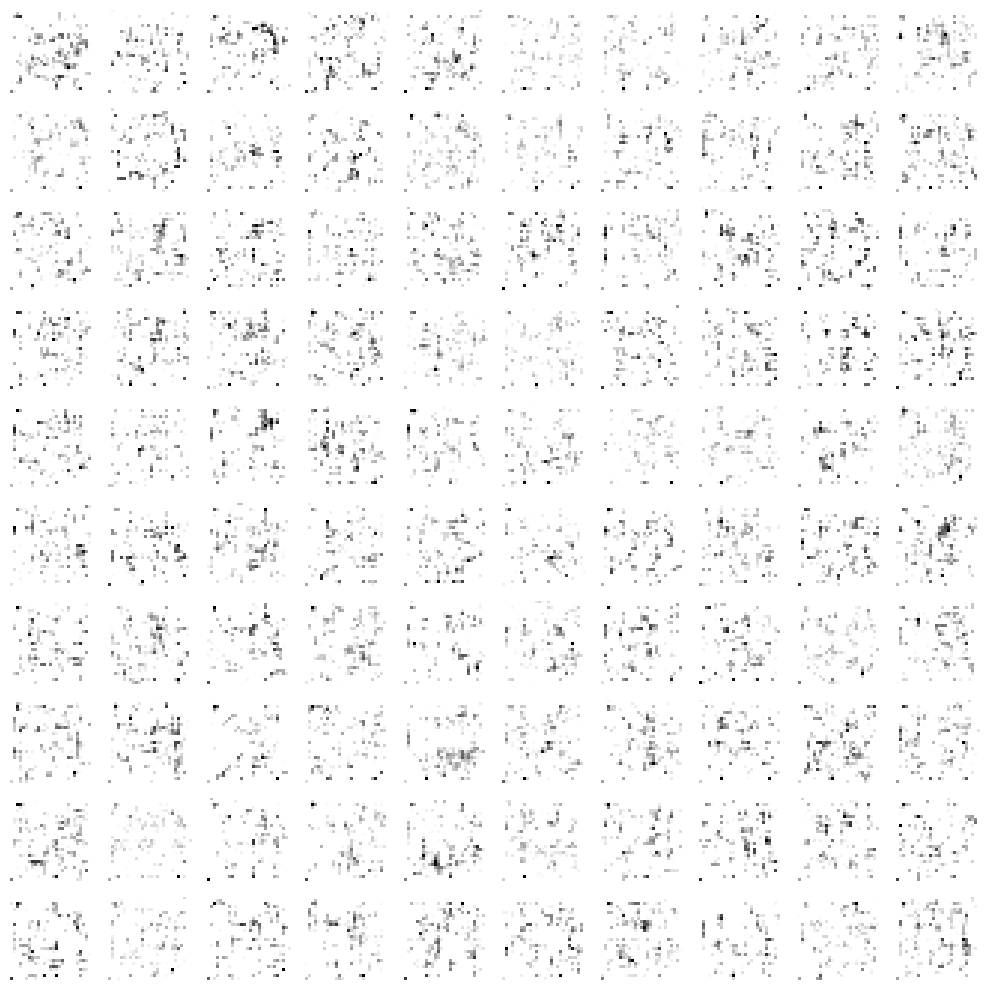

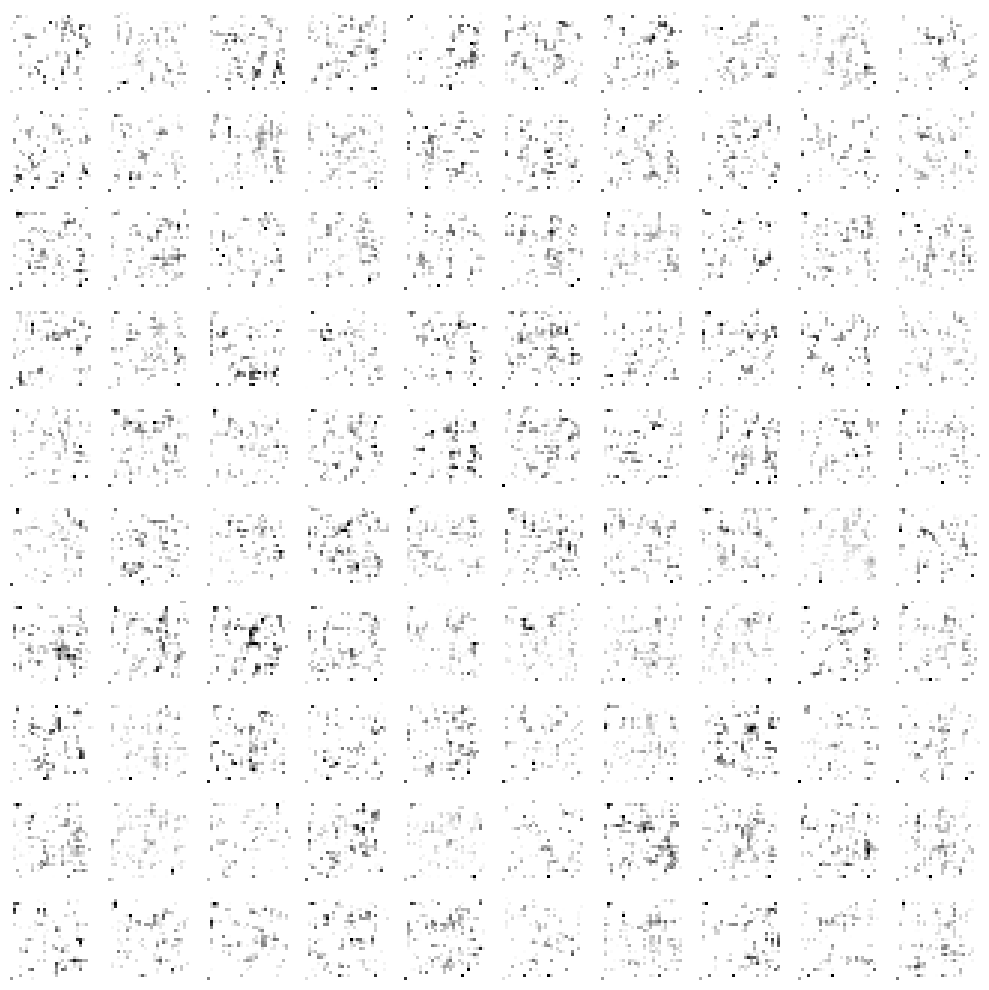

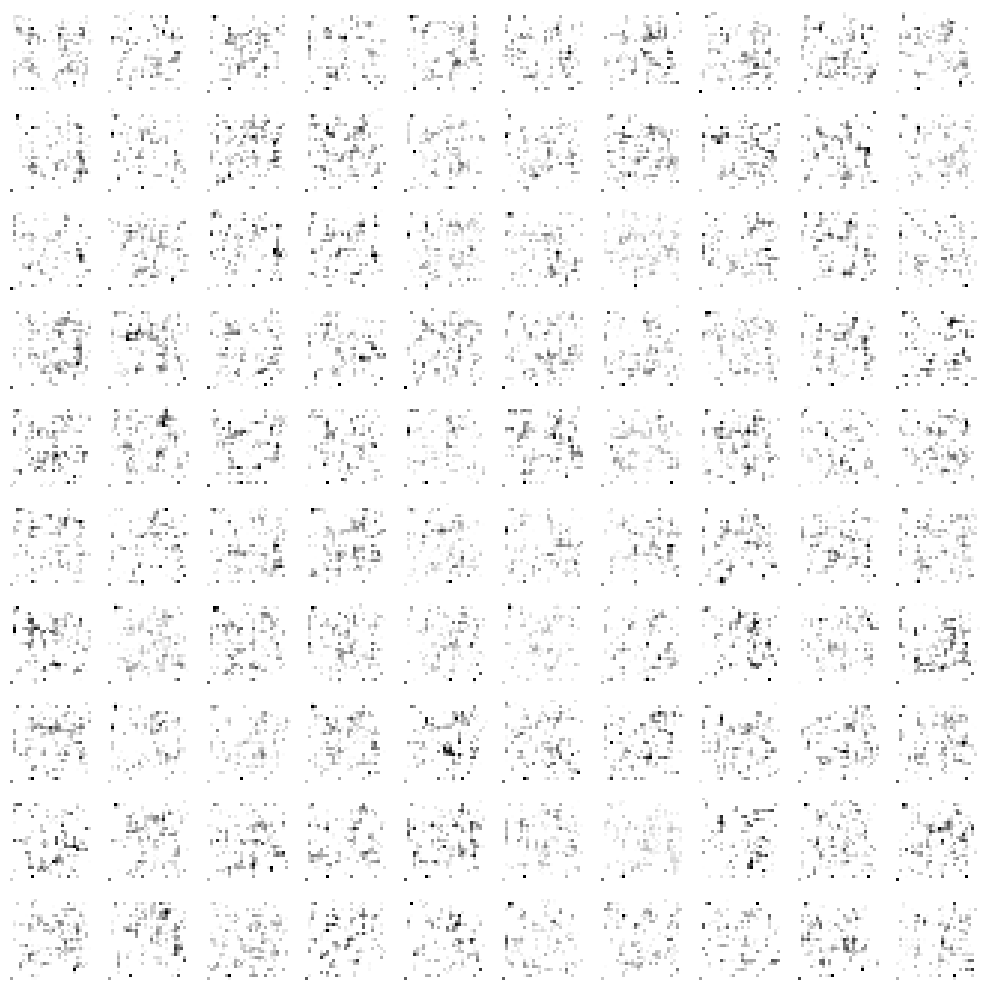

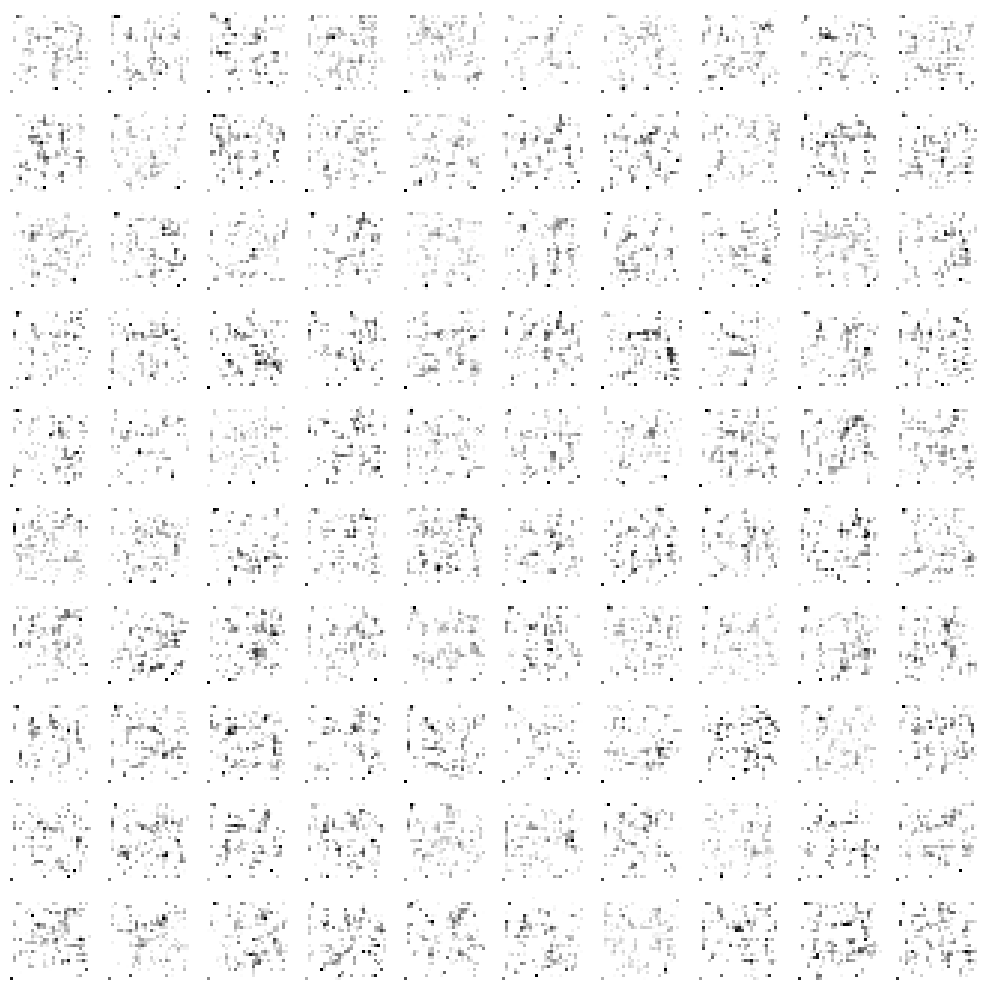

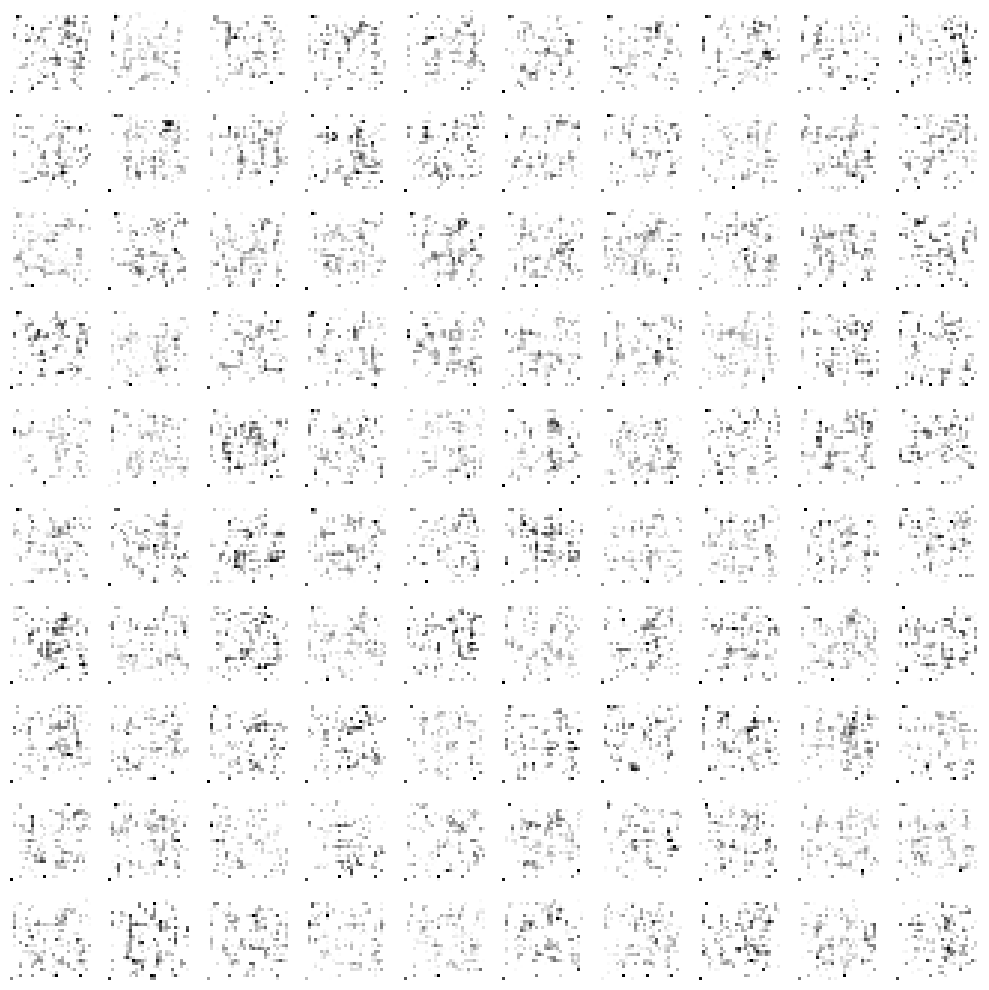

...

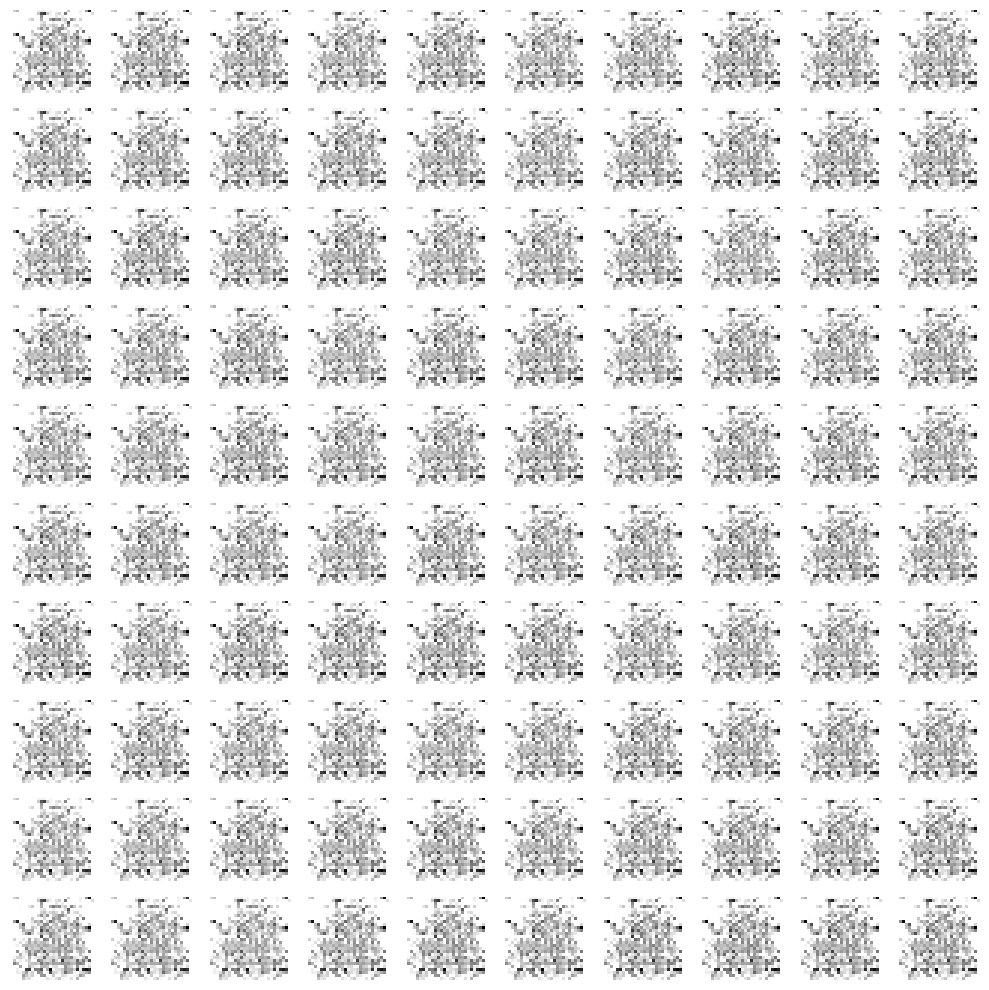

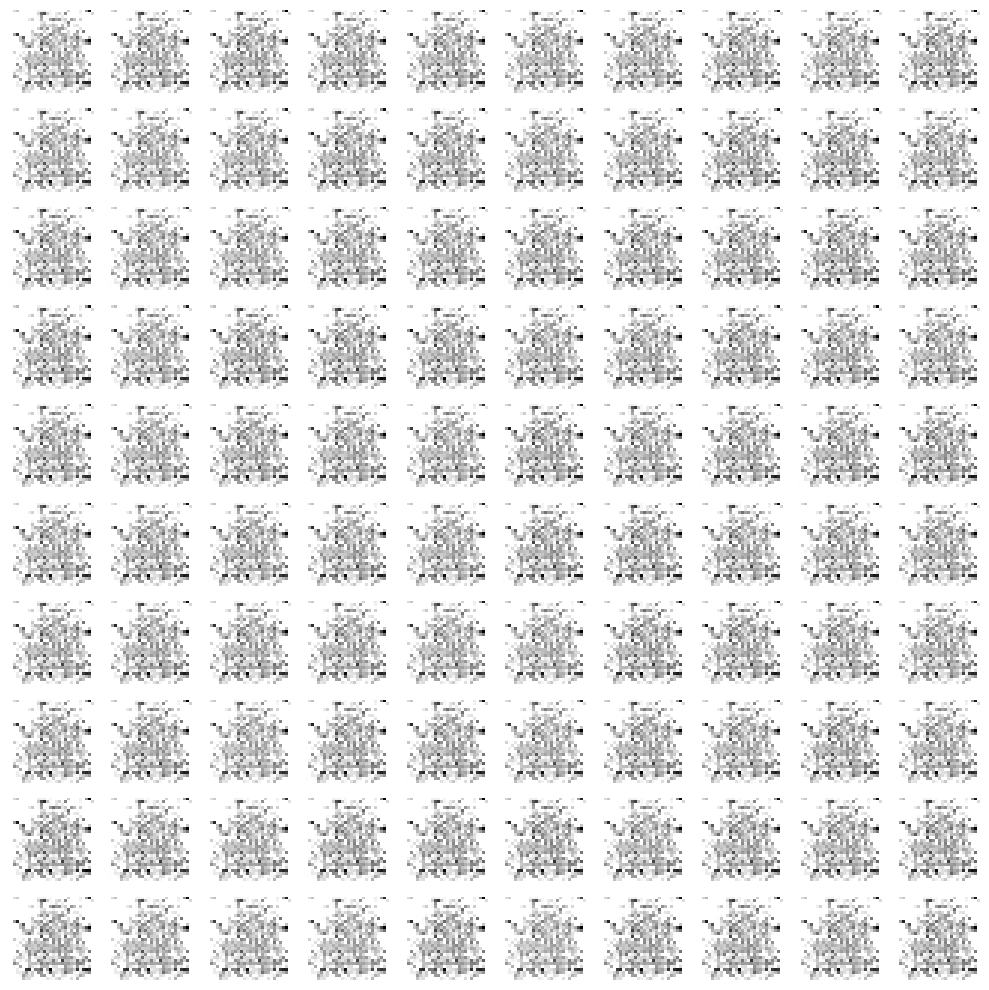

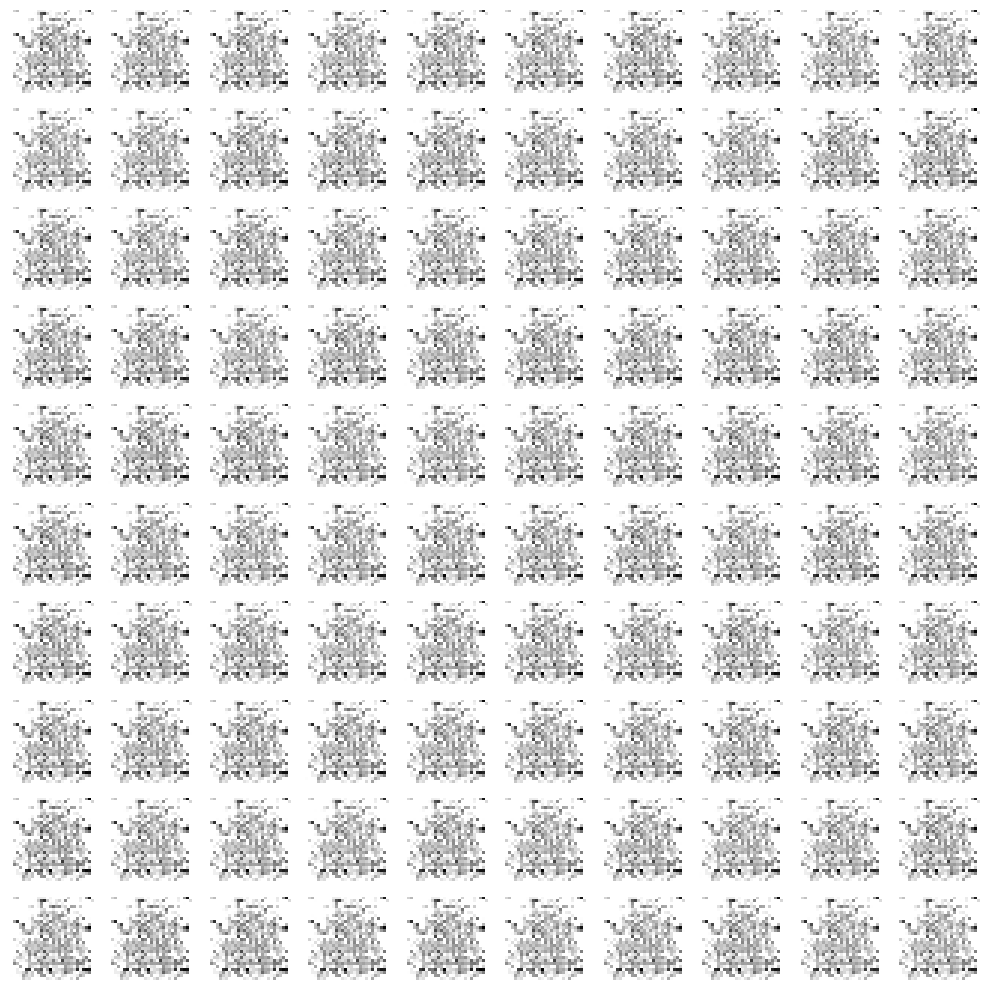

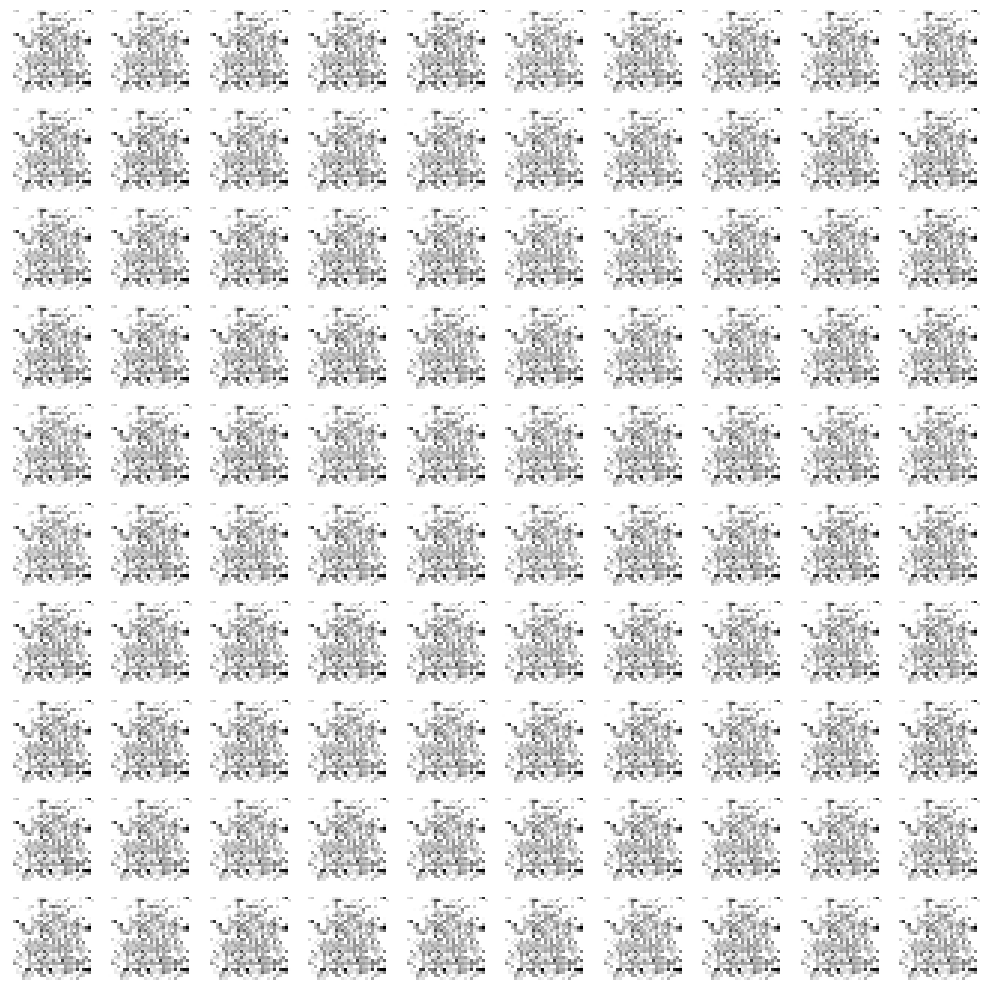

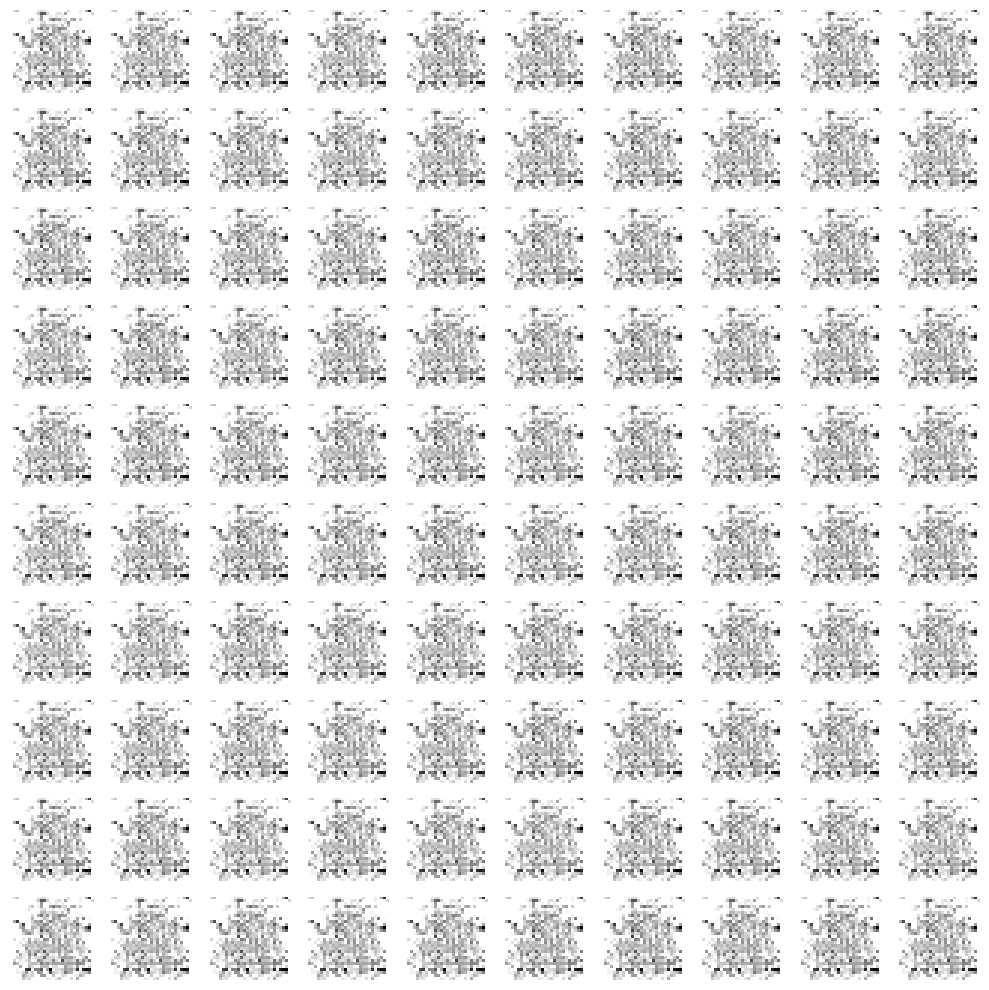

In [16]:
train(epochs=10000, batch_size=32, save_interval=50)